## This file is the old pipeline, use better-pipeline for the latest version made to work with scraper's output.

## Preprocessing

In [32]:
import cv2
import numpy as np
from pathlib import Path
import os

# -------------------------------
# Individual preprocessing steps
# -------------------------------

def apply_clahe(img):
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8, 8))
    cl = clahe.apply(l)
    limg = cv2.merge((cl, a, b))
    return cv2.cvtColor(limg, cv2.COLOR_LAB2BGR)

def adjust_gamma(image, gamma=1.2):
    invGamma = 1.0 / gamma
    table = np.array([
        ((i / 255.0) ** invGamma) * 255 for i in np.arange(256)
    ]).astype("uint8")
    return cv2.LUT(image, table)

def unsharp_mask(image):
    blurred = cv2.GaussianBlur(image, (0, 0), sigmaX=1)
    return cv2.addWeighted(image, 1.5, blurred, -0.5, 0)

def emphasize_edges_sobel(image, strength=0.6):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    sobel = cv2.magnitude(sobelx, sobely)
    sobel = cv2.convertScaleAbs(sobel)
    sobel_color = cv2.cvtColor(sobel, cv2.COLOR_GRAY2BGR)
    return cv2.addWeighted(image, 1.0, sobel_color, strength, 0)

# -------------------------------
# Full preprocessing pipeline
# -------------------------------

def preprocess_image(img_path):
    img = cv2.imread(str(img_path))
    if img is None:
        print(f"Warning: Could not read image {img_path}")
        return None
    img = apply_clahe(img)
    img = adjust_gamma(img, gamma=1.2)
    img = unsharp_mask(img)
    img = emphasize_edges_sobel(img, strength=0.6)
    return img

# -------------------------------
# Patch cropper (optional)
# -------------------------------

def crop_to_patches(image, patch_size=512, stride=256):
    patches = []
    h, w, _ = image.shape
    for y in range(0, h - patch_size + 1, stride):
        for x in range(0, w - patch_size + 1, stride):
            patch = image[y:y+patch_size, x:x+patch_size]
            patches.append((patch, x, y))
    return patches

# -------------------------------
# Batch preprocessing with optional patch saving
# -------------------------------

def batch_preprocess_images(input_dir, output_dir, patching=False, patch_size=512, stride=256):
    input_dir = Path(input_dir)
    output_dir = Path(output_dir)
    output_dir.mkdir(parents=True, exist_ok=True)

    image_extensions = ['.jpg', '.jpeg', '.png']
    for img_path in input_dir.glob("*"):
        if img_path.suffix.lower() not in image_extensions:
            continue

        processed = preprocess_image(img_path)
        if processed is not None:
            if patching:
                patches = crop_to_patches(processed, patch_size, stride)
                for idx, (patch, x, y) in enumerate(patches):
                    patch_name = f"{img_path.stem}_patch_{y}_{x}{img_path.suffix}"
                    out_path = output_dir / patch_name
                    cv2.imwrite(str(out_path), patch)
            else:
                out_path = output_dir / img_path.name
                cv2.imwrite(str(out_path), processed)
            print(f"Processed: {img_path.name}")

# -------------------------------
# Example usage
# -------------------------------

if __name__ == "__main__":
    input_folder = "../raw"
    output_folder = "../preprocessed"
    enable_patching = True  # Set to False to disable patch cropping
    # batch_preprocess_images(input_folder, output_folder, patching=enable_patching)
    batch_preprocess_images(input_folder, output_folder)



Processed: c1188040640.jpg
Processed: w1005446235.jpg
Processed: h1187769830.jpg
Processed: t1186927159.jpg
Processed: m1155389414.jpg
Processed: n1186326582.jpg
Processed: q1187995280.jpg
Processed: d1005441369.jpg
Processed: f1188140202.jpg
Processed: f1186102032.jpg
Processed: n1188831148.jpg
Processed: f1171787858.jpg
Processed: 1183527755.jpg
Processed: m1001998019.jpg
Processed: g1187771936.jpg
Processed: j1187535718.jpg
Processed: 1188404659.jpg
Processed: s1187141394.jpg
Processed: v1188308383.jpg
Processed: k1188248403.jpg
Processed: t1185233436.jpg
Processed: t1182792139.jpg
Processed: h1169857891.jpg
Processed: f1188770225.jpg
Processed: v1184067515.jpg


### Upscale Images

In [23]:
import os
import cv2

# Input directory
INPUT_DIR = "../preprocessed"

# Choose scale factor
SCALE_FACTOR = 3  # 2× upscaling

# Loop over all files
for filename in os.listdir(INPUT_DIR):
    input_path = os.path.join(INPUT_DIR, filename)

    # Skip non-image files
    if not (
        filename.lower().endswith(".jpg") or
        filename.lower().endswith(".jpeg") or
        filename.lower().endswith(".png")
    ):
        continue

    # Read the image
    img = cv2.imread(input_path)

    if img is None:
        print(f"Skipping {filename}: could not read image.")
        continue

    # Compute new size
    new_width = int(img.shape[1] * SCALE_FACTOR)
    new_height = int(img.shape[0] * SCALE_FACTOR)

    # Resize using Lanczos4 for better clarity
    resized_img = cv2.resize(
        img,
        (new_width, new_height),
        interpolation=cv2.INTER_LANCZOS4
    )

    # Overwrite the original image
    cv2.imwrite(input_path, resized_img)

    print(f"Upscaled {filename} to {new_width}×{new_height}")

print("All images processed.")

Upscaled c1188040640.jpg to 1800×1347
Upscaled w1005446235.jpg to 3600×2700
Upscaled h1187769830.jpg to 3600×2700
Upscaled t1186927159.jpg to 3600×2700
Upscaled m1155389414.jpg to 3600×2700
Upscaled n1186326582.jpg to 3600×2700
Upscaled q1187995280.jpg to 3600×2700
Upscaled d1005441369.jpg to 3600×2700
Upscaled f1188140202.jpg to 2025×3600
Upscaled f1186102032.jpg to 3600×2700
Upscaled n1188831148.jpg to 2700×3600
Upscaled f1171787858.jpg to 3600×3600
Upscaled 1183527755.jpg to 3600×3600
Upscaled m1001998019.jpg to 3600×2700
Upscaled g1187771936.jpg to 3600×2700
Upscaled j1187535718.jpg to 3600×3600
Upscaled 1188404659.jpg to 2700×3600
Upscaled s1187141394.jpg to 2700×3600
Upscaled v1188308383.jpg to 1920×1440
Upscaled k1188248403.jpg to 3600×2700
Upscaled t1185233436.jpg to 3600×3600
Upscaled t1182792139.jpg to 2700×3600
Upscaled h1169857891.jpg to 3600×3600
Upscaled f1188770225.jpg to 3600×2385
Upscaled v1184067515.jpg to 3600×3600
All images processed.


## GroundingDINO Inference

In [33]:
# Input and output directories
INPUT_DIR = "../preprocessed"
OUTPUT_DIR = "../output"
OUTPUT_LABELS_DIR = "../output_labels"
GOLDEN_FILE = "../data/golden.json"

In [142]:
# Configurable thresholds and prompt
TEXT_PROMPT = "individual boxes. dual window device."
BOX_THRESHOLD = 0.25
TEXT_THRESHOLD = 0.25
GOLDEN_SWITCH = False    ## Display Golden Data
REMOVE_NESTING = False   ## Nesting Filtering during inference

In [143]:
import time

# Record the start time
start_time = time.time() 

In [144]:
from groundingdino.util.inference import load_model, load_image, predict, annotate
import os
import cv2
import torch

# Load the model once
model = load_model(
    "./groundingdino/config/GroundingDINO_SwinB_cfg.py",
    "./weights/groundingdino_swinb_cogcoor.pth"
)

# Create output directories if they don't exist
os.makedirs(OUTPUT_DIR, exist_ok=True)
os.makedirs(OUTPUT_LABELS_DIR, exist_ok=True)

# Loop over all image files in the input directory
for filename in os.listdir(INPUT_DIR):
    input_path = os.path.join(INPUT_DIR, filename)

    # Skip non-image files
    if not (
        filename.lower().endswith(".jpg") or
        filename.lower().endswith(".jpeg") or
        filename.lower().endswith(".png")
    ):
        continue

    base_filename = os.path.splitext(filename)[0]

    # Load the image
    image_source, image = load_image(input_path)
    hgt, wid = image_source.shape[:2]

    # Predict boxes, logits, phrases
    boxes, logits, phrases = predict(
        model=model,
        image=image,
        caption=TEXT_PROMPT,
        box_threshold=BOX_THRESHOLD,
        text_threshold=TEXT_THRESHOLD
    )

    # Prepare detections: keep both normalized and absolute coordinates
    detections = []
    for i in range(len(boxes)):
        cx_norm, cy_norm, w_norm, h_norm = boxes[i].tolist()

        # Convert to absolute pixel coordinates for filtering and saving
        cx_abs = cx_norm * wid
        cy_abs = cy_norm * hgt
        w_abs = w_norm * wid
        h_abs = h_norm * hgt

        x_min = cx_abs - w_abs / 2
        y_min = cy_abs - h_abs / 2
        x_max = cx_abs + w_abs / 2
        y_max = cy_abs + h_abs / 2

        area = w_abs * h_abs

        phrase = phrases[i] if phrases[i] else "NIL"
        detections.append({
            "box_norm": [cx_norm, cy_norm, w_norm, h_norm],  # For annotate()
            "box_abs": [x_min, y_min, x_max, y_max],         # For filtering and saving
            "logit": logits[i],
            "phrase": phrase,
            "area": area
        })

    if REMOVE_NESTING:
        detections_sorted = sorted(detections, key=lambda d: d["area"], reverse=True)
        remove_indices = set()

        for det_big in detections_sorted[:3]:
            box_big = det_big["box_abs"]
            phrase_big = det_big["phrase"]

            for det_small in detections:
                if det_small is det_big:
                    continue
                box_small = det_small["box_abs"]
                if (
                    box_small[0] >= box_big[0] and
                    box_small[1] >= box_big[1] and
                    box_small[2] <= box_big[2] and
                    box_small[3] <= box_big[3]
                ):
                    remove_indices.add(id(det_big))
                    break

        detections = [d for d in detections if id(d) not in remove_indices]

    # Reconstruct lists for annotation
    final_boxes = [d["box_norm"] for d in detections]   # Normalized format for annotate()
    final_logits = [d["logit"] for d in detections]
    final_phrases = [d["phrase"] for d in detections]

    # Convert to tensor safely
    if final_boxes:
        final_boxes_tensor = torch.tensor(final_boxes)
    else:
        final_boxes_tensor = torch.empty((0, 4))

    # Annotate the image (same style as before)
    annotated_frame = annotate(
        image_source=image_source,
        boxes=final_boxes_tensor,
        logits=final_logits,
        phrases=final_phrases
    )

    # Save the annotated image
    output_path = os.path.join(OUTPUT_DIR, filename)
    cv2.imwrite(output_path, annotated_frame)

    # Save detection metadata (absolute coordinates)
    output_label_path = os.path.join(
        OUTPUT_LABELS_DIR,
        base_filename + ".txt"
    )
    with open(output_label_path, "w") as f:
        for det in detections:
            x_min, y_min, x_max, y_max = det["box_abs"]
            line = (
                f"{det['phrase']} {det['logit']:.4f} "
                f"{x_min:.2f} {y_min:.2f} {x_max:.2f} {y_max:.2f}\n"
            )
            f.write(line)

    print(f"Processed {filename} -> {output_path}")

print("All images processed.")


final text_encoder_type: bert-base-uncased
Processed c1188040640.jpg -> ../output/c1188040640.jpg
Processed w1005446235.jpg -> ../output/w1005446235.jpg
Processed h1187769830.jpg -> ../output/h1187769830.jpg
Processed t1186927159.jpg -> ../output/t1186927159.jpg
Processed m1155389414.jpg -> ../output/m1155389414.jpg
Processed n1186326582.jpg -> ../output/n1186326582.jpg
Processed q1187995280.jpg -> ../output/q1187995280.jpg
Processed d1005441369.jpg -> ../output/d1005441369.jpg
Processed f1188140202.jpg -> ../output/f1188140202.jpg
Processed f1186102032.jpg -> ../output/f1186102032.jpg
Processed n1188831148.jpg -> ../output/n1188831148.jpg
Processed f1171787858.jpg -> ../output/f1171787858.jpg
Processed 1183527755.jpg -> ../output/1183527755.jpg
Processed m1001998019.jpg -> ../output/m1001998019.jpg
Processed g1187771936.jpg -> ../output/g1187771936.jpg
Processed j1187535718.jpg -> ../output/j1187535718.jpg
Processed 1188404659.jpg -> ../output/1188404659.jpg
Processed s1187141394.jpg 

## Visualize images

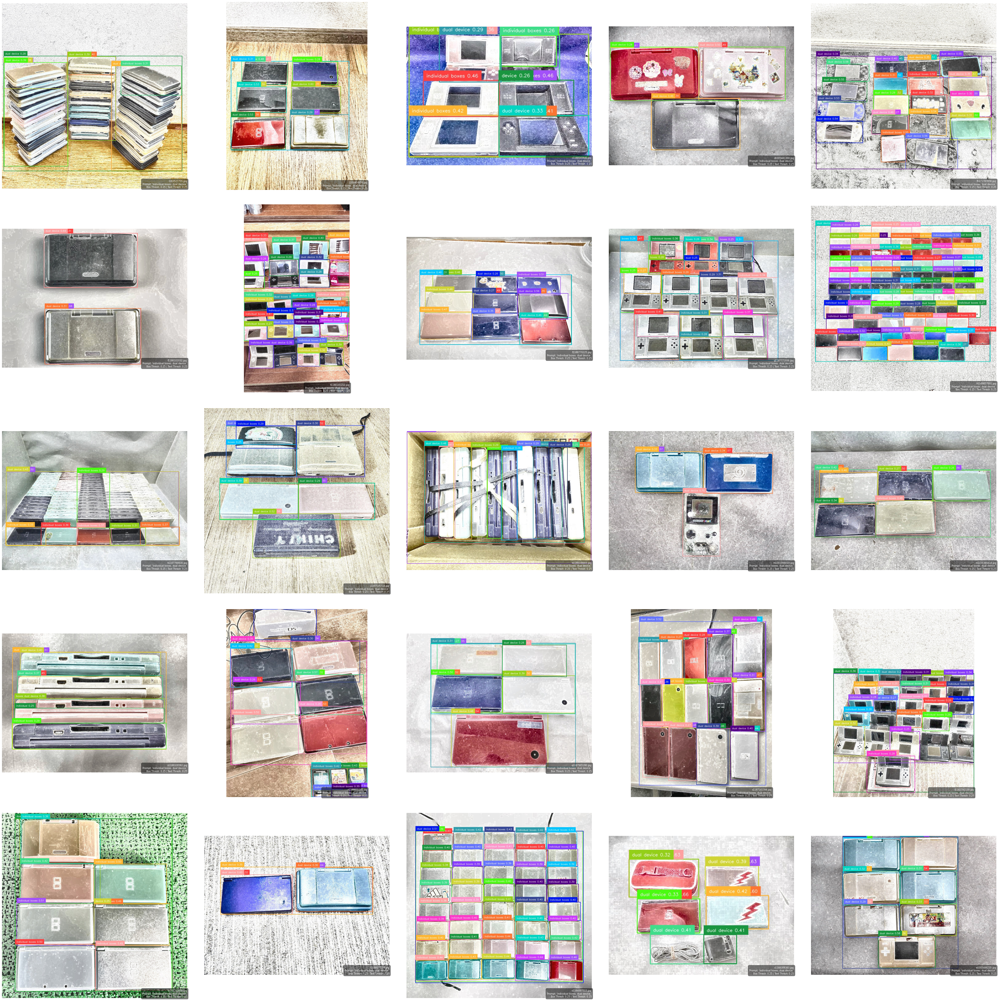

In [145]:
import matplotlib.pyplot as plt
import os
from math import ceil
import json

valid_image_ext = ['.jpg']

def visualize_images(
    output_path,
    golden_path,
    num_cols=2,
    num_images=10,
    prompt="",
    box_thresh=0.0,
    text_thresh=0.0,
    show_golden=False
):
    # Load golden data if needed
    golden_data = {}
    if show_golden:
        with open(golden_path, "r") as f:
            golden_data = json.load(f)

    # Gather images
    image_paths = [
        os.path.join(output_path, image)
        for image in sorted(os.listdir(output_path))
        if os.path.splitext(image)[1].lower() in valid_image_ext
    ]

    num_images = min(num_images, len(image_paths))
    num_rows = int(ceil(float(num_images) / float(num_cols)))

    f, axarr = plt.subplots(num_rows, num_cols, figsize=(num_cols * 10, num_rows * 10))
    f.tight_layout(pad=3.0)
    axarr = axarr.flatten()

    for idx in range(num_rows * num_cols):
        ax = axarr[idx]
        ax.axis('off')

        if idx < num_images:
            img_path = image_paths[idx]
            img = plt.imread(img_path)

            filename_stem = os.path.splitext(os.path.basename(img_path))[0]

            # Retrieve golden data if enabled
            if show_golden:
                record = golden_data.get(filename_stem, {})
                if record:
                    table_str = "\n".join([f"{k}: {v}" for k, v in record.items()])
                else:
                    table_str = "No golden data."
            else:
                table_str = ""

            # Compose overlay text
            overlay_text = (
                f"{os.path.basename(img_path)}\n"
                f"Prompt: '{prompt}'\n"
                f"Box Thresh: {box_thresh} | Text Thresh: {text_thresh}"
            )
            if show_golden:
                overlay_text += f"\n{table_str}"

            # Show image
            ax.imshow(img)

            # Overlay text in bottom right
            ax.text(
                1.0, 0.0,           # bottom right
                overlay_text,
                ha='right',
                va='bottom',
                fontsize=8,
                color='white',
                wrap=True,
                transform=ax.transAxes,
                bbox=dict(
                    facecolor='black',
                    alpha=0.5,
                    boxstyle='round,pad=0.5'
                )
            )

# Visualizing the sample images
IMAGE_DIR = OUTPUT_DIR
COLS = 5
IMAGES = 25

visualize_images(
    IMAGE_DIR,
    GOLDEN_FILE,
    num_cols=COLS,
    num_images=IMAGES,
    prompt=TEXT_PROMPT,
    box_thresh=BOX_THRESHOLD,
    text_thresh=TEXT_THRESHOLD,
    show_golden=GOLDEN_SWITCH
)

